In [2]:
# Đảm bảo cài UTF-8
import locale
locale.getpreferredencoding = lambda: "UTF-8"

# Cập nhật pip và cài ultralytics
!pip install --upgrade pip
!pip install --upgrade ultralytics

In [3]:
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [4]:
# Nhập các thư viện
import os
import cv2
import shutil
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from ultralytics import YOLO
import torch
import torchvision
from torchvision import transforms, datasets, models
from torchvision.models import ResNet50_Weights
from torch.utils.data import DataLoader
import torch.nn as nn
import torch.optim as optim
from PIL import Image

### Phần chạy trên kaggle

In [5]:
# !rm -rf '/kaggle/working/*'

In [6]:
# src_dir = "/kaggle/input/tomatoes/Riped and Unriped Tomato Dataset/"
# dst_dir = "/kaggle/working/tomatoes/Riped and Unriped Tomato Dataset"

# shutil.copytree(src_dir, dst_dir, dirs_exist_ok=True)

In [7]:
# Định nghĩa các đường dẫn chính
dataset_path = '/content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset' # /kaggle/working/tomatoes/Riped and Unriped Tomato Dataset/'
images_path = os.path.join(dataset_path, 'images')
labels_path = os.path.join(dataset_path, 'labels')
tests_path = os.path.join(dataset_path, 'tests')

# Kiểm tra sự tồn tại của các đường dẫn
if os.path.exists(dataset_path) and os.path.exists(images_path) and os.path.exists(labels_path) and os.path.exists(tests_path):
    print("All directories exist!")
else:
    print("Some directories are missing!")
    exit()

All directories exist!


In [8]:
# Lấy các ảnh và label
image_files = sorted([f for f in os.listdir(images_path) if f.endswith('.jpeg')])
label_files = sorted([f for f in os.listdir(labels_path) if f.endswith('.txt')])
print(f"Number of images: {len(image_files)}")
print(f"Number of labels: {len(label_files)}")
if len(image_files) != len(label_files):
    print("Warning: Mismatch between images and labels. Checking pairs...")
    image_names = {f.replace('.jpeg', '') for f in image_files}
    label_names = {f.replace('.txt', '') for f in label_files}
    missing_labels = image_names - label_names
    missing_images = label_names - image_names
    if missing_labels:
        print(f"Images missing labels: {missing_labels}")
    if missing_images:
        print(f"Labels missing images: {missing_images}")
    exit()

Number of images: 1126
Number of labels: 1126


In [9]:
# Chia dữ liệu train và test theo tỉ lệ 8:2
image_paths = [os.path.join(images_path, img) for img in image_files]
label_paths = [os.path.join(labels_path, lbl) for lbl in label_files]
train_images, val_images, train_labels, val_labels = train_test_split(
    image_paths, label_paths, test_size=0.2, random_state=42
)
print(f"Number of training images: {len(train_images)}")
print(f"Number of validation images: {len(val_images)}")

Number of training images: 900
Number of validation images: 226


In [10]:
# Tạo thư mục mặc định cho YOLO
os.makedirs(os.path.join(dataset_path, 'images/train'), exist_ok=True)
os.makedirs(os.path.join(dataset_path, 'images/val'), exist_ok=True)
os.makedirs(os.path.join(dataset_path, 'labels/train'), exist_ok=True)
os.makedirs(os.path.join(dataset_path, 'labels/val'), exist_ok=True)

### Chỉ chạy lần đầu tiên

In [11]:
# for img_path, lbl_path in zip(train_images, train_labels):
#     shutil.copy(img_path, os.path.join(dataset_path, 'images/train', os.path.basename(img_path)))
#     shutil.copy(lbl_path, os.path.join(dataset_path, 'labels/train', os.path.basename(lbl_path)))

In [12]:
# for img_path, lbl_path in zip(val_images, val_labels):
#     shutil.copy(img_path, os.path.join(dataset_path, 'images/val', os.path.basename(img_path)))
#     shutil.copy(lbl_path, os.path.join(dataset_path, 'labels/val', os.path.basename(lbl_path)))

In [13]:
# Tạo đường dẫn tới các thư mục dùng để phát hiện cà chua
train_label_dir = os.path.join(dataset_path, 'labels/train')
val_label_dir = os.path.join(dataset_path, 'labels/val')
new_train_label_dir = os.path.join(dataset_path, 'labels_detection/train')
new_val_label_dir = os.path.join(dataset_path, 'labels_detection/val')

In [14]:
# Điều chỉnh các label cho quá trình phát hiện cà chua
def modify_labels(label_dir, new_label_dir):
    os.makedirs(new_label_dir, exist_ok=True)
    for lbl_file in os.listdir(label_dir):
        if lbl_file.endswith('.txt'):
            file_path = os.path.join(label_dir, lbl_file)
            new_file_path = os.path.join(new_label_dir, lbl_file)
            with open(file_path, 'r') as f:
                lines = f.readlines()
            new_lines = []
            modified = False
            for line in lines:
                parts = line.strip().split()
                if len(parts) == 5:
                    try:
                        class_id = int(parts[0])
                        x_center, y_center, w, h = map(float, parts[1:])
                        # Chỉ 1 nhãn 0 = cà chua
                        parts[0] = '0'
                        # Điều chỉnh các giá trị lỗi
                        if w <= 0:
                            parts[3] = '0.01'
                            modified = True
                        if h <= 0:
                            parts[4] = '0.01'
                            modified = True
                        # Bỏ qua nếu label vẫn không hợp lệ
                        if not (0 <= x_center <= 1 and 0 <= y_center <= 1 and 0 < w <= 1 and 0 < h <= 1):
                            print(f"Skipping invalid box in {lbl_file}: {line.strip()}")
                            modified = True
                            continue
                        new_lines.append(' '.join(parts))
                    except ValueError:
                        print(f"Skipping non-numeric line in {lbl_file}: {line.strip()}")
                        modified = True
                        continue
                else:
                    print(f"Skipping malformed line in {lbl_file}: {line.strip()}")
                    modified = True
                    continue
            if new_lines:
                with open(new_file_path, 'w') as f:
                    f.write('\n'.join(new_lines))
                if modified:
                    print(f"Fixed issues in {lbl_file}")
            else:
                print(f"Skipping empty or invalid label file: {lbl_file}")

modify_labels(train_label_dir, new_train_label_dir)
modify_labels(val_label_dir, new_val_label_dir)

In [15]:
# Tạo file .yaml cho việc phát hiện cà chua
# /kaggle/working/tomatoes/Riped and Unriped Tomato Dataset/images/train
# /kaggle/working/tomatoes/Riped and Unriped Tomato Dataset/images/val
dataset_yaml = """
train: /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/images/train
val: /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/images/val
nc: 1
names: ['tomato']
"""
yaml_path = os.path.join(dataset_path, 'tomatoes_detection.yaml')
with open(yaml_path, 'w') as file:
    file.write(dataset_yaml)

In [16]:
# Kiểm tra lại tương thích ảnh và label
def validate_labels(label_dir, image_dir):
    invalid_files = []
    label_files = [f for f in os.listdir(label_dir) if f.endswith('.txt')]
    image_files = [f.replace('.jpeg', '.txt') for f in os.listdir(image_dir) if f.endswith('.jpeg')]
    # Kiểm tra label bị mất ảnh
    for img_file in image_files:
        if img_file not in label_files:
            invalid_files.append((img_file, "Mất label"))
    # Kiểm tra lại label có trong tầm vực đúng hay không
    for lbl_file in label_files:
        file_path = os.path.join(label_dir, lbl_file)
        with open(file_path, 'r') as f:
            lines = f.readlines()
        if not lines:
            invalid_files.append((lbl_file, "Tệp label rỗng"))
            continue
        for line in lines:
            parts = line.strip().split()
            if len(parts) != 5:
                invalid_files.append((lbl_file, f"Số lượng thành phần trong label khác 5: {line.strip()}"))
                continue
            try:
                class_id = int(parts[0])
                x_center, y_center, w, h = map(float, parts[1:])
                if class_id != 0:
                    invalid_files.append((lbl_file, f"Sai mã label: {class_id}"))
                if not (0 <= x_center <= 1 and 0 <= y_center <= 1):
                    invalid_files.append((lbl_file, f"Sai vị trí tâm box: {x_center}, {y_center}"))
                if not (0 < w <= 1 and 0 < h <= 1):
                    invalid_files.append((lbl_file, f"Kích thước box bị sai: w={w}, h={h}"))
            except ValueError:
                invalid_files.append((lbl_file, f"Các giá trị không phải số: {line.strip()}"))
    return invalid_files

train_label_errors = validate_labels(new_train_label_dir, os.path.join(dataset_path, 'images/train'))
val_label_errors = validate_labels(new_val_label_dir, os.path.join(dataset_path, 'images/val'))
if train_label_errors or val_label_errors:
    print("Lỗi tìm label:")
    for err in train_label_errors + val_label_errors:
        print(f"File {err[0]}: {err[1]}")
    exit()
else:
    print("Tất cả label đều được kiểm tra ổn áp")

Tất cả label đều được kiểm tra ổn áp


In [17]:
# Đường dẫn cũ và mới
old_labels = os.path.join(dataset_path, 'labels')
old_detection = os.path.join(dataset_path, 'labels_detection')
new_cls = os.path.join(dataset_path, 'labels_cls')
new_labels = os.path.join(dataset_path, 'labels')

# Đổi tên labels -> labels_cls (nhãn phân loại)
if os.path.exists(old_labels):
    os.rename(old_labels, new_cls)
    print(f"Đã đổi tên 'labels' → 'labels_cls'")
else:
    print(f"Không tìm thấy thư mục 'labels' để đổi tên.")

# Đổi tên labels_detection -> labels (dùng cho YOLO)
if os.path.exists(old_detection):
    os.rename(old_detection, new_labels)
    print(f"Đã đổi tên 'labels_detection' → 'labels'")
else:
    print(f"Không tìm thấy thư mục 'labels_detection' để đổi tên.")


Đã đổi tên 'labels' → 'labels_cls'
Đã đổi tên 'labels_detection' → 'labels'


## Phần huấn luyện

In [18]:
# Huấn luyện bằng YOLO để phát hiện cà chua
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
detection_model = YOLO('yolov8s.pt')
results = detection_model.train(
    data=yaml_path,
    epochs=50,
    imgsz=640,
    device=0,
    lr0=0.01,
    lrf=0.001,
    save_period=10,
    batch=64,
    weight_decay=0.0005,
    augment=False,
    workers=2,
    verbose=True,
)
detection_model.save(os.path.join(dataset_path, 'tomato_detection_model.pt'))

100%|██████████| 21.5M/21.5M [00:00<00:00, 236MB/s]


Ultralytics 8.3.110 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tomatoes_detection.yaml, epochs=50, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=10, cache=False, device=0, workers=2, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fal

100%|██████████| 755k/755k [00:00<00:00, 20.0MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 101MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.5±0.2 ms, read: 0.3±0.1 MB/s, size: 107.8 KB)


train: Scanning /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/labels/train... 900 images, 0 backgrounds, 0 corrupt: 100%|██████████| 900/900 [00:29<00:00, 30.73it/s] 


train: New cache created: /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 1.0±0.3 ms, read: 0.2±0.1 MB/s, size: 83.4 KB)


val: Scanning /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/labels/val... 226 images, 0 backgrounds, 0 corrupt: 100%|██████████| 226/226 [00:08<00:00, 25.69it/s]

val: New cache created: /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      13.3G      1.573      2.087      1.707         36        640: 100%|██████████| 15/15 [00:26<00:00,  1.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.82s/it]

                   all        226       1337      0.748      0.544      0.592      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50        13G      1.414      1.242      1.486         14        640: 100%|██████████| 15/15 [00:23<00:00,  1.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:08<00:00,  4.00s/it]

                   all        226       1337      0.697      0.569      0.586      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      13.4G      1.417      1.099       1.49         28        640: 100%|██████████| 15/15 [00:28<00:00,  1.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.17s/it]

                   all        226       1337      0.409      0.279      0.225     0.0949



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      12.9G        1.4      1.039      1.482         29        640: 100%|██████████| 15/15 [00:22<00:00,  1.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.94s/it]

                   all        226       1337      0.232       0.28      0.129     0.0458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      13.2G      1.484      1.125       1.54         30        640: 100%|██████████| 15/15 [00:22<00:00,  1.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.73s/it]

                   all        226       1337     0.0478      0.197     0.0227     0.0069



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      13.2G      1.464      1.089      1.537         18        640: 100%|██████████| 15/15 [00:24<00:00,  1.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.74s/it]

                   all        226       1337    0.00372      0.154    0.00214   0.000697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      13.1G      1.448      1.109      1.548         26        640: 100%|██████████| 15/15 [00:23<00:00,  1.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.12s/it]

                   all        226       1337     0.0359      0.199     0.0165    0.00627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      12.9G      1.489      1.157       1.59         21        640: 100%|██████████| 15/15 [00:26<00:00,  1.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.17s/it]

                   all        226       1337      0.108       0.23       0.06     0.0259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      13.4G        1.4       1.06      1.515         22        640: 100%|██████████| 15/15 [00:23<00:00,  1.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.09s/it]

                   all        226       1337     0.0888      0.337     0.0491     0.0213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50        13G      1.395      1.025      1.497         53        640: 100%|██████████| 15/15 [00:24<00:00,  1.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.51s/it]

                   all        226       1337      0.508      0.381      0.356      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      13.1G      1.374      1.042      1.493         13        640: 100%|██████████| 15/15 [00:26<00:00,  1.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.17s/it]

                   all        226       1337      0.633       0.51      0.501      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      12.9G      1.325     0.9529      1.442         27        640: 100%|██████████| 15/15 [00:22<00:00,  1.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.74s/it]

                   all        226       1337      0.599      0.551      0.527      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50        13G      1.312     0.9147      1.443         34        640: 100%|██████████| 15/15 [00:21<00:00,  1.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.10s/it]

                   all        226       1337      0.718      0.573      0.581      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      12.9G      1.302      0.928       1.44         31        640: 100%|██████████| 15/15 [00:22<00:00,  1.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.21s/it]

                   all        226       1337      0.704      0.602      0.615      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50        13G      1.298      0.907      1.425         27        640: 100%|██████████| 15/15 [00:21<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.74s/it]

                   all        226       1337      0.729      0.564      0.623      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50        13G      1.281     0.9094      1.434         18        640: 100%|██████████| 15/15 [00:25<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all        226       1337      0.193      0.546       0.14     0.0759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50        13G      1.279     0.8791      1.423         24        640: 100%|██████████| 15/15 [00:23<00:00,  1.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.50s/it]

                   all        226       1337      0.766      0.636      0.661      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      13.2G      1.267     0.8647      1.407         36        640: 100%|██████████| 15/15 [00:22<00:00,  1.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.96s/it]

                   all        226       1337      0.748      0.647      0.685      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      13.1G      1.265     0.8189      1.387         46        640: 100%|██████████| 15/15 [00:24<00:00,  1.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.21s/it]

                   all        226       1337      0.811      0.673      0.713      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50        13G      1.201     0.8088      1.373         35        640: 100%|██████████| 15/15 [00:23<00:00,  1.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.33s/it]

                   all        226       1337       0.81      0.655        0.7      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      13.4G      1.211     0.8431       1.38         17        640: 100%|██████████| 15/15 [00:25<00:00,  1.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all        226       1337      0.819       0.64      0.687      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      12.8G      1.203     0.7957      1.363         47        640: 100%|██████████| 15/15 [00:22<00:00,  1.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.09s/it]

                   all        226       1337      0.785      0.674      0.708       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      13.1G      1.201     0.7898      1.359         28        640: 100%|██████████| 15/15 [00:23<00:00,  1.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.02s/it]

                   all        226       1337      0.813      0.659      0.712      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      12.9G      1.146     0.7635      1.328         34        640: 100%|██████████| 15/15 [00:23<00:00,  1.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.08s/it]

                   all        226       1337      0.815      0.683      0.724      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      13.5G      1.139     0.7484      1.339         17        640: 100%|██████████| 15/15 [00:24<00:00,  1.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.17s/it]

                   all        226       1337      0.811      0.682      0.712      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      12.9G      1.126     0.7322      1.322         24        640: 100%|██████████| 15/15 [00:24<00:00,  1.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.05s/it]

                   all        226       1337      0.807      0.669      0.716      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      13.7G      1.122      0.701      1.309         32        640: 100%|██████████| 15/15 [00:24<00:00,  1.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.70s/it]

                   all        226       1337      0.819      0.686      0.716      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      13.1G      1.104     0.7022      1.288         43        640: 100%|██████████| 15/15 [00:24<00:00,  1.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.05s/it]

                   all        226       1337      0.849      0.689      0.732      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      13.1G      1.093     0.6951      1.289         35        640: 100%|██████████| 15/15 [00:26<00:00,  1.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.59s/it]

                   all        226       1337      0.839      0.673       0.73      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50        13G      1.143      0.714      1.315         29        640: 100%|██████████| 15/15 [00:26<00:00,  1.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.45s/it]

                   all        226       1337      0.876      0.681       0.74      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      13.1G      1.093     0.7002        1.3         32        640: 100%|██████████| 15/15 [00:27<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all        226       1337      0.825      0.683      0.713       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50        13G      1.063     0.6391      1.263         32        640: 100%|██████████| 15/15 [00:26<00:00,  1.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.69s/it]

                   all        226       1337      0.836      0.658      0.719      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      13.4G      1.059     0.6526      1.274         45        640: 100%|██████████| 15/15 [00:24<00:00,  1.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.64s/it]

                   all        226       1337      0.851      0.678      0.734      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      13.1G      1.049     0.6561      1.268         23        640: 100%|██████████| 15/15 [00:24<00:00,  1.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.70s/it]

                   all        226       1337      0.859       0.69      0.747      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      13.4G      1.046     0.6343      1.257         36        640: 100%|██████████| 15/15 [00:24<00:00,  1.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.10s/it]

                   all        226       1337      0.859      0.693      0.739      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50        13G      1.011     0.6241      1.246         19        640: 100%|██████████| 15/15 [00:24<00:00,  1.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.23s/it]

                   all        226       1337      0.836      0.705      0.737      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      13.6G      1.009     0.6259      1.244         44        640: 100%|██████████| 15/15 [00:24<00:00,  1.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.99s/it]

                   all        226       1337       0.87      0.699       0.75      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      13.1G     0.9873      0.623      1.242         13        640: 100%|██████████| 15/15 [00:25<00:00,  1.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.94s/it]

                   all        226       1337      0.837      0.681      0.738      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      13.1G     0.9898     0.5999      1.222         27        640: 100%|██████████| 15/15 [00:25<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.24s/it]

                   all        226       1337      0.854       0.68      0.732      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      13.1G     0.9589     0.5885      1.203         30        640: 100%|██████████| 15/15 [00:20<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all        226       1337      0.854      0.705      0.749      0.497


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      13.6G     0.9512     0.5543      1.213         20        640: 100%|██████████| 15/15 [00:31<00:00,  2.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.93s/it]

                   all        226       1337      0.837      0.688      0.733      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      12.7G     0.9444     0.5134      1.213         12        640: 100%|██████████| 15/15 [00:22<00:00,  1.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.93s/it]

                   all        226       1337      0.869       0.68      0.738      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      13.3G     0.9555     0.4924       1.21         37        640: 100%|██████████| 15/15 [00:22<00:00,  1.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.09s/it]

                   all        226       1337      0.857       0.71      0.751      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      12.8G     0.9639      0.493      1.195         23        640: 100%|██████████| 15/15 [00:20<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.28s/it]

                   all        226       1337      0.876      0.697      0.757      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      13.1G      0.921     0.5007      1.175         28        640: 100%|██████████| 15/15 [00:20<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.49s/it]

                   all        226       1337      0.899      0.678      0.756      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      12.8G     0.8727     0.4659      1.165         14        640: 100%|██████████| 15/15 [00:21<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.55s/it]

                   all        226       1337      0.869      0.701      0.755      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      13.9G     0.8927     0.4577      1.166         21        640: 100%|██████████| 15/15 [00:22<00:00,  1.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.73s/it]

                   all        226       1337      0.889      0.692      0.759      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      12.8G      0.832     0.4329      1.122         18        640: 100%|██████████| 15/15 [00:20<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.32s/it]

                   all        226       1337      0.876      0.709      0.761      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      13.1G     0.9033     0.5451      1.203         17        640: 100%|██████████| 15/15 [00:21<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.60s/it]

                   all        226       1337      0.896      0.701      0.766      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      12.8G      0.817     0.4307      1.122         15        640: 100%|██████████| 15/15 [00:20<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.50s/it]

                   all        226       1337      0.881      0.703      0.762       0.52



50 epochs completed in 0.422 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.110 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.86s/it]


                   all        226       1337      0.897      0.701      0.766      0.521
Speed: 0.3ms preprocess, 8.6ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/train


In [19]:
# Đường dẫn hiện tại
labels_cls = os.path.join(dataset_path, 'labels_cls')       # nhãn phân loại (sẽ đổi thành labels)
labels_yolo = os.path.join(dataset_path, 'labels')          # nhãn detection (sẽ đổi thành labels_detection)
new_detection = os.path.join(dataset_path, 'labels_detection')
new_labels = os.path.join(dataset_path, 'labels')

# Đổi labels → labels_detection (trả YOLO về đúng chỗ)
if os.path.exists(labels_yolo):
    os.rename(labels_yolo, new_detection)
    print(f"Đã đổi 'labels' → 'labels_detection'")
else:
    print(f"Không tìm thấy thư mục 'labels' để đổi sang 'labels_detection'")
    exit()

# Đổi labels_cls → labels (trả nhãn phân loại về lại tên cũ)
if os.path.exists(labels_cls):
    os.rename(labels_cls, new_labels)
    print(f"Đã đổi 'labels_cls' → 'labels'")
else:
    print(f"Không tìm thấy thư mục 'labels_cls' để đổi sang 'labels'")
    exit()

✅ Đã đổi 'labels' → 'labels_detection'
✅ Đã đổi 'labels_cls' → 'labels'


In [20]:
# Tạo box để phân loại
def create_cropped_dataset(images_dir, labels_dir, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    for img_file in os.listdir(images_dir):
        if img_file.endswith('.jpeg'):
            img_path = os.path.join(images_dir, img_file)
            label_path = os.path.join(labels_dir, img_file.replace('.jpeg', '.txt'))
            if not os.path.exists(label_path):
                print(f"Bỏ qua ảnh không có label: {img_file}")
                continue
            image = cv2.imread(img_path)
            if image is None:
                print(f"Bỏ qua ảnh không tồn tại: {img_file}")
                continue
            height, width, _ = image.shape
            with open(label_path, 'r') as f:
                lines = f.readlines()
            for i, line in enumerate(lines):
                parts = line.strip().split()
                if len(parts) == 5:
                    try:
                        class_id = int(parts[0])
                        x_center = float(parts[1]) * width
                        y_center = float(parts[2]) * height
                        w = float(parts[3]) * width
                        h = float(parts[4]) * height
                        x1 = int(x_center - w / 2)
                        y1 = int(y_center - h / 2)
                        x2 = int(x_center + w / 2)
                        y2 = int(y_center + h / 2)
                        x1, x2 = max(0, x1), min(width, x2)
                        y1, y2 = max(0, y1), min(height, y2)
                        if x2 > x1 and y2 > y1:
                            crop = image[y1:y2, x1:x2]
                            label_name = 'unriped' if class_id == 0 else 'riped'
                            crop_filename = f"{img_file.split('.')[0]}_crop_{i}_{label_name}.jpeg"
                            cv2.imwrite(os.path.join(output_dir, crop_filename), crop)
                    except (ValueError, IndexError):
                        print(f"Skipping invalid label in {img_file}: {line.strip()}")

cropped_train_dir = os.path.join(dataset_path, 'cropped_train')
cropped_val_dir = os.path.join(dataset_path, 'cropped_val')
create_cropped_dataset(
    os.path.join(dataset_path, 'images/train'),
    os.path.join(dataset_path, 'labels/train'),
    cropped_train_dir
)
create_cropped_dataset(
    os.path.join(dataset_path, 'images/val'),
    os.path.join(dataset_path, 'labels/val'),
    cropped_val_dir
)

In [21]:
# Tổ chức thư mục phân loại
for dir_path, dir_name in [(cropped_train_dir, 'cropped_train'), (cropped_val_dir, 'cropped_val')]:
    unripe_dir = os.path.join(dir_path, 'unripe')
    ripe_dir = os.path.join(dir_path, 'ripe')
    os.makedirs(unripe_dir, exist_ok=True)
    os.makedirs(ripe_dir, exist_ok=True)
    for file in os.listdir(dir_path):
        if file.endswith('.jpeg'):
            if '_unripe' in file:
                shutil.move(os.path.join(dir_path, file), os.path.join(unripe_dir, file))
            elif '_ripe' in file:
                shutil.move(os.path.join(dir_path, file), os.path.join(ripe_dir, file))

In [22]:
# Huấn luyện phân loại bằng ResNet50
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
train_dataset = datasets.ImageFolder(cropped_train_dir, transform=transform) # 0 là chín, 1 là chưa (alphabets)
val_dataset = datasets.ImageFolder(cropped_val_dir, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# Khởi tạo ResNet50 với pre-trained weights
classifier = models.resnet50(weights='IMAGENET1K_V2')
classifier.fc = nn.Linear(classifier.fc.in_features, 2)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(classifier.parameters(), lr=0.001)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
classifier.to(device)

for epoch in range(15):
    classifier.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = classifier(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    print(f'Epoch {epoch+1}, Loss: {running_loss / len(train_loader)}')
    classifier.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = classifier(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    print(f'Validation Accuracy: {100 * correct / total}%')

torch.save(classifier.state_dict(), os.path.join(dataset_path, 'tomato_classifier.pth'))

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 142MB/s]


Epoch 1, Loss: 0.2551659653106561
Validation Accuracy: 91.8474195961107%
Epoch 2, Loss: 0.17810174812777685
Validation Accuracy: 92.22139117427075%
Epoch 3, Loss: 0.15889497062621208
Validation Accuracy: 92.22139117427075%
Epoch 4, Loss: 0.12976472701590794
Validation Accuracy: 90.05235602094241%
Epoch 5, Loss: 0.14884562392074327
Validation Accuracy: 91.69783096484667%
Epoch 6, Loss: 0.11784595467436772
Validation Accuracy: 92.07180254300673%
Epoch 7, Loss: 0.1087729656137526
Validation Accuracy: 92.29618548990277%
Epoch 8, Loss: 0.10065612186892675
Validation Accuracy: 92.89454001495886%
Epoch 9, Loss: 0.08480881177641164
Validation Accuracy: 92.22139117427075%
Epoch 10, Loss: 0.07956758026356021
Validation Accuracy: 90.94988780852655%
Epoch 11, Loss: 0.0737915593987474
Validation Accuracy: 93.41810022438295%
Epoch 12, Loss: 0.06648345848437971
Validation Accuracy: 91.3238593866866%
Epoch 13, Loss: 0.051175817664569384
Validation Accuracy: 92.37097980553477%
Epoch 14, Loss: 0.0666906

In [23]:
%matplotlib inline
def predict_ripeness(image_path, detection_model, classifier, transform, device):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Failed to load image: {image_path}")
        return
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = detection_model(image_path, conf=0.5, iou=0.6)
    boxes = results[0].boxes.xyxy.cpu().numpy()
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = map(int, box)
        crop = image_rgb[y1:y2, x1:x2]
        if crop.size == 0:
            print(f"Skipping empty crop at box {i} in {image_path}")
            continue
        crop_pil = Image.fromarray(crop)
        crop_tensor = transform(crop_pil).unsqueeze(0).to(device)
        classifier.eval()
        with torch.no_grad():
            output = classifier(crop_tensor)
            _, predicted = torch.max(output, 1)
            is_riped = 0 if predicted.item() else 1
            label = 'riped' if is_riped else 'unriped'
            color = (255, 0 , 0) if is_riped else (0, 255, 0)
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f'Predictions for {os.path.basename(image_path)}')
    plt.axis('off')
    plt.show()

## Phần test

In [24]:
# Tải model lên
detection_model = YOLO(os.path.join(dataset_path, 'tomato_detection_model.pt'))
classifier = models.resnet50(weights=None)
classifier.fc = nn.Linear(classifier.fc.in_features, 2)
classifier.load_state_dict(torch.load(os.path.join(dataset_path, 'tomato_classifier.pth')))
classifier.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [25]:
import gc
test_images = [os.path.join(tests_path, f) for f in os.listdir(tests_path) if f.endswith('.jpg')]


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_58.jpg: 448x640 11 tomatos, 25.8ms
Speed: 2.4ms preprocess, 25.8ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


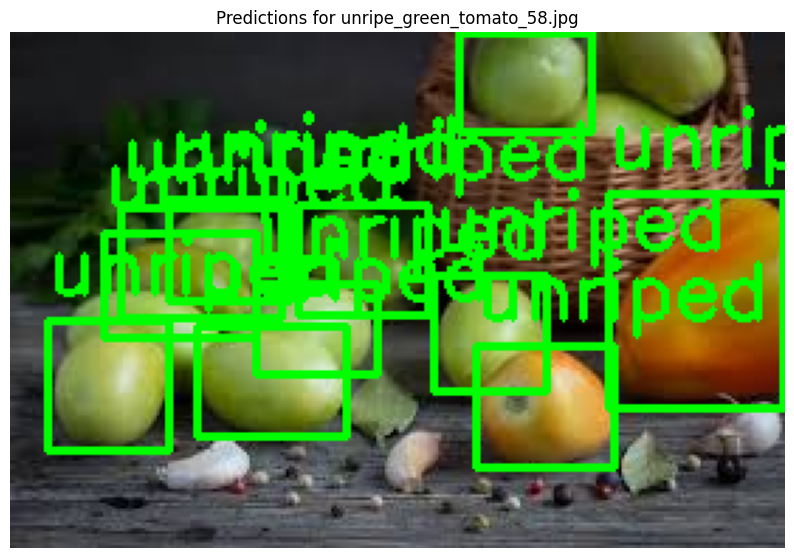


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_99.jpg: 640x480 1 tomato, 23.3ms
Speed: 3.4ms preprocess, 23.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


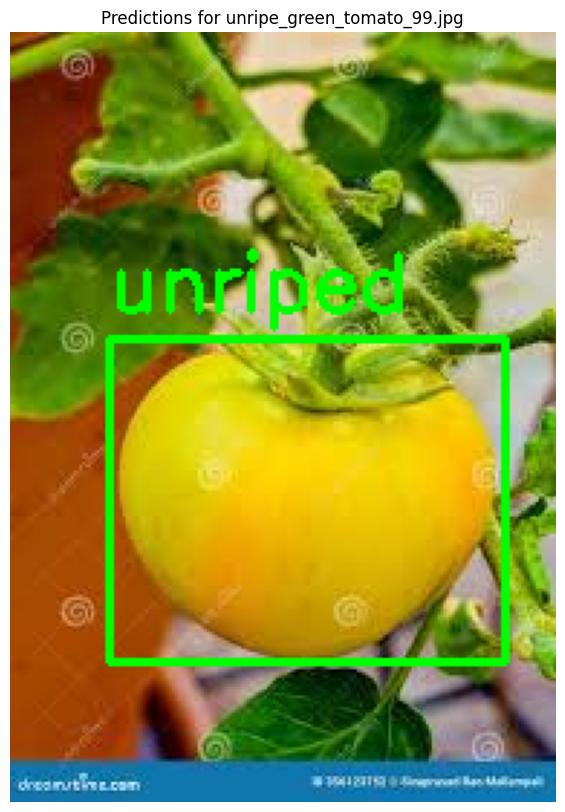


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_82.jpg: 448x640 1 tomato, 36.4ms
Speed: 3.0ms preprocess, 36.4ms inference, 2.5ms postprocess per image at shape (1, 3, 448, 640)


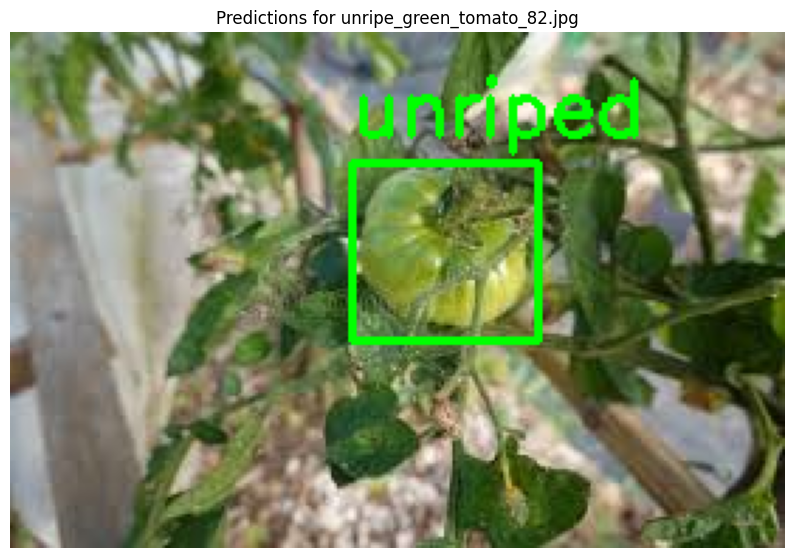


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_51.jpg: 640x512 9 tomatos, 304.6ms
Speed: 8.2ms preprocess, 304.6ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 512)


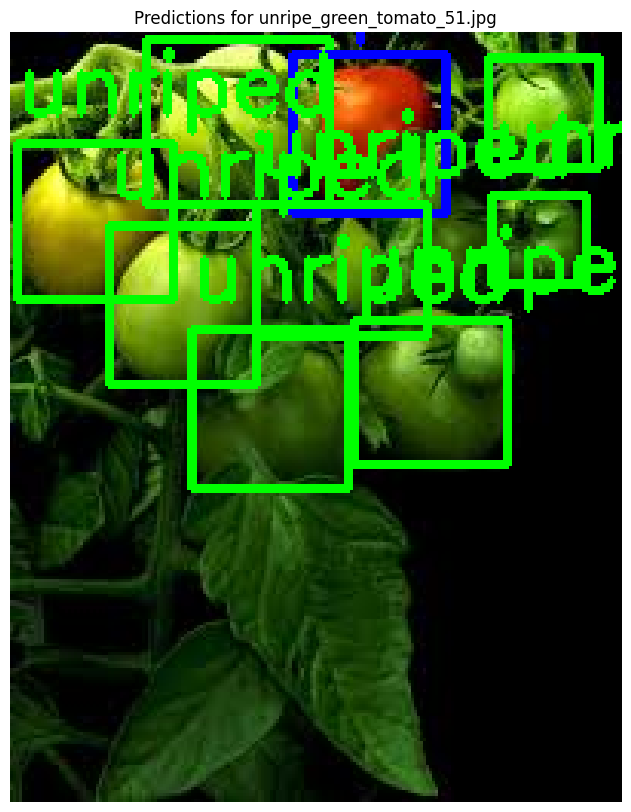


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_83.jpg: 480x640 2 tomatos, 26.5ms
Speed: 4.3ms preprocess, 26.5ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


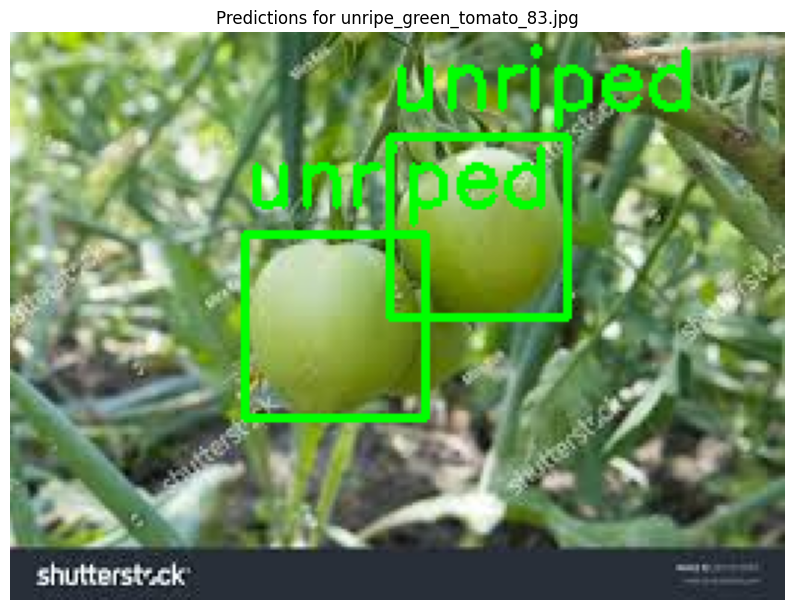


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/42.jpg: 448x640 2 tomatos, 26.6ms
Speed: 4.4ms preprocess, 26.6ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)


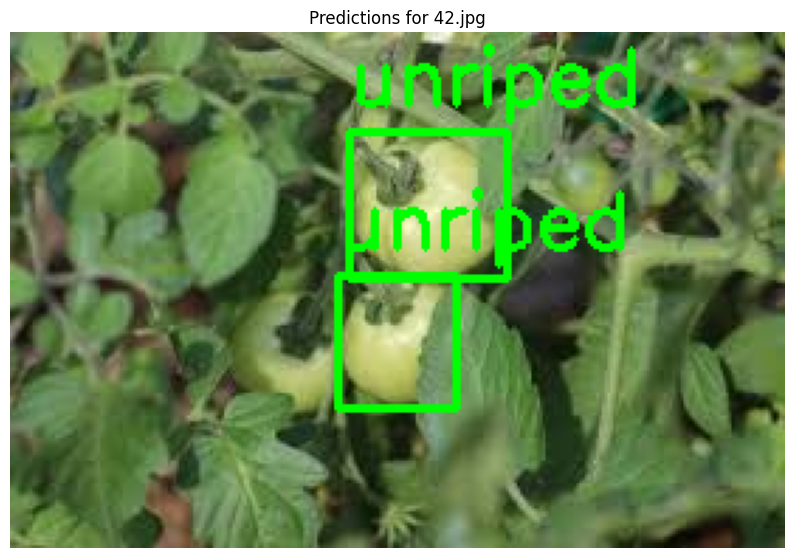


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_115.jpg: 640x576 9 tomatos, 69.5ms
Speed: 4.5ms preprocess, 69.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 576)


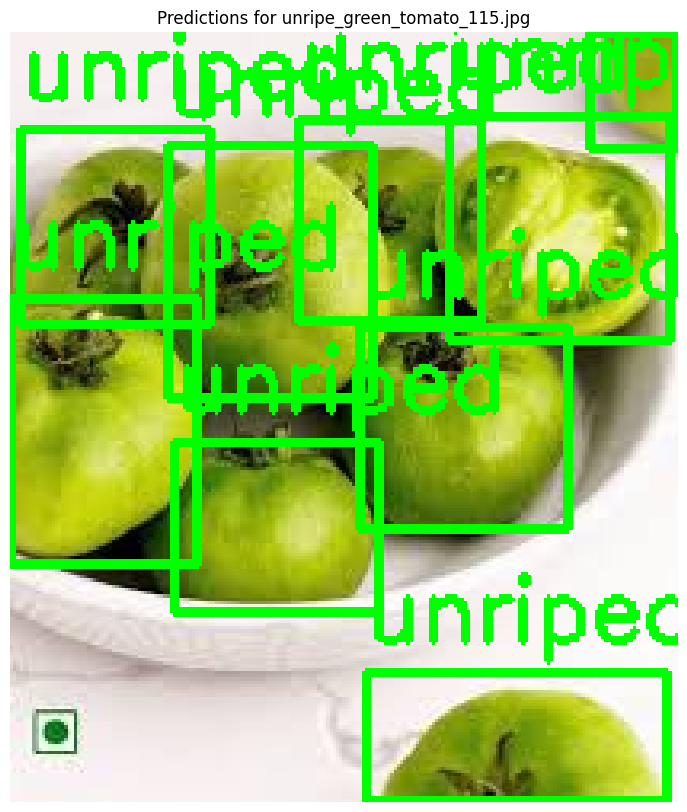


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_101.jpg: 448x640 1 tomato, 28.0ms
Speed: 3.2ms preprocess, 28.0ms inference, 2.5ms postprocess per image at shape (1, 3, 448, 640)


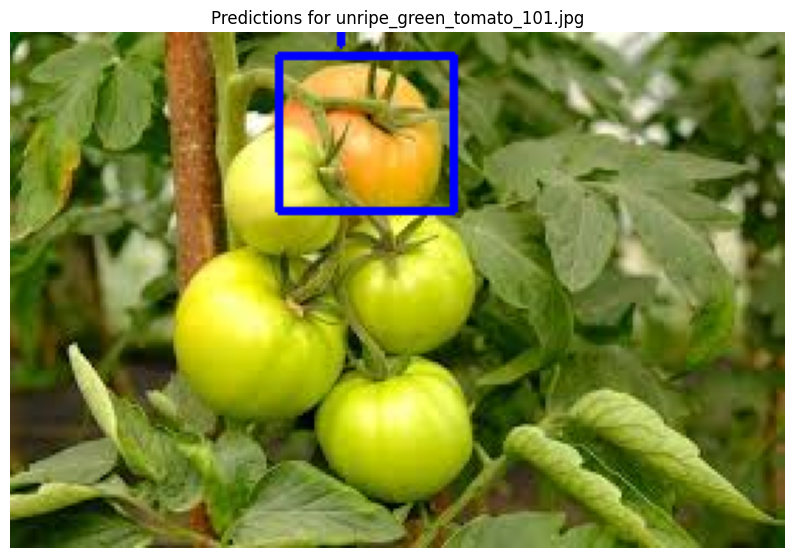


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/45.jpg: 640x384 2 tomatos, 27.8ms
Speed: 3.0ms preprocess, 27.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 384)


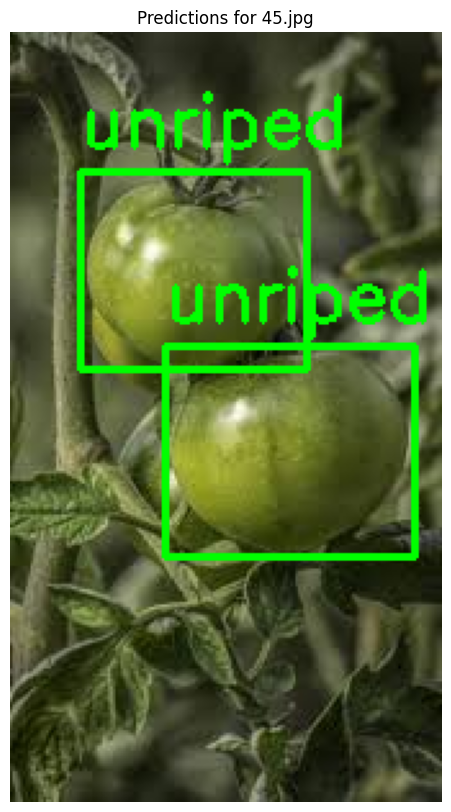


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/41.jpg: 448x640 4 tomatos, 27.1ms
Speed: 3.1ms preprocess, 27.1ms inference, 2.4ms postprocess per image at shape (1, 3, 448, 640)


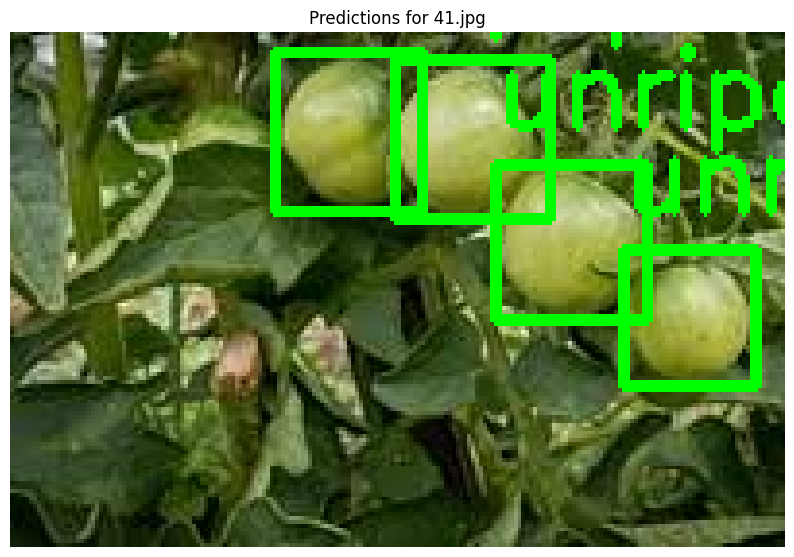


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_86.jpg: 448x640 5 tomatos, 25.3ms
Speed: 3.5ms preprocess, 25.3ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)


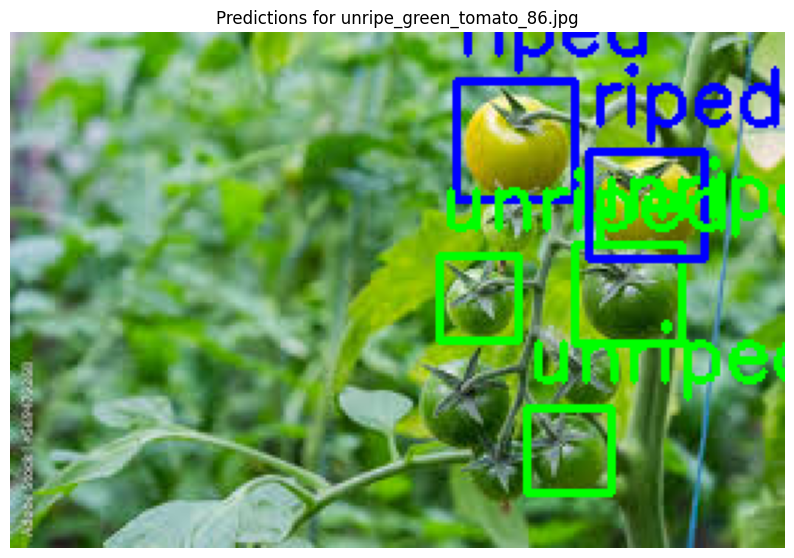


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_80.jpg: 640x544 3 tomatos, 78.4ms
Speed: 3.9ms preprocess, 78.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 544)


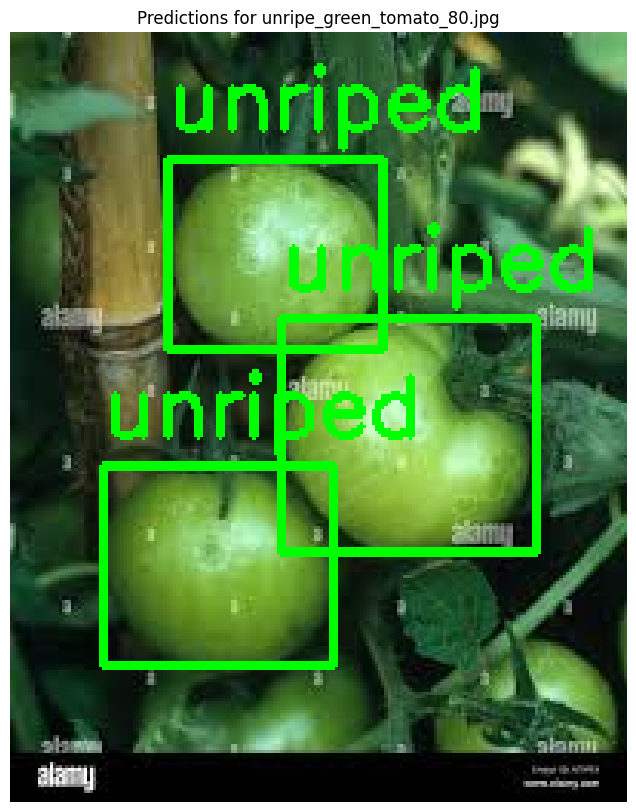


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_81.jpg: 640x480 1 tomato, 35.1ms
Speed: 4.4ms preprocess, 35.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 480)


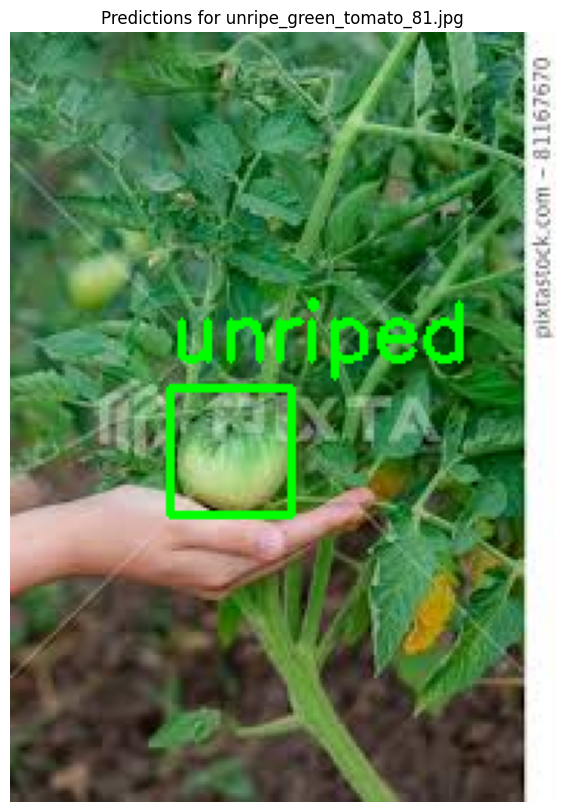


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/14.jpg: 640x448 12 tomatos, 24.6ms
Speed: 3.9ms preprocess, 24.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 448)


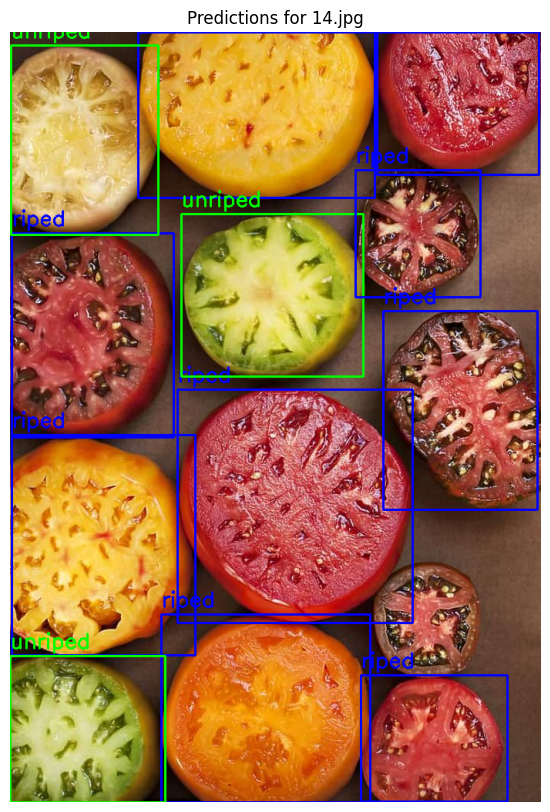


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/15.jpg: 640x448 (no detections), 28.6ms
Speed: 3.7ms preprocess, 28.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 448)


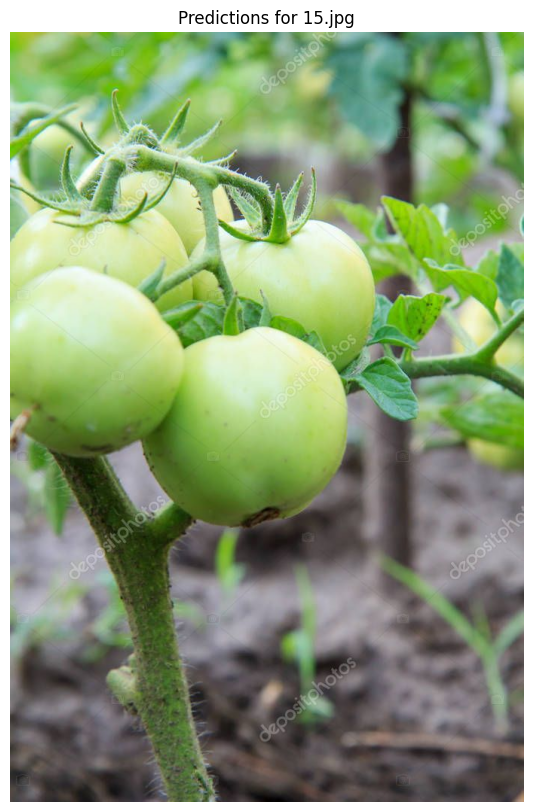


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_72.jpg: 480x640 1 tomato, 26.5ms
Speed: 3.5ms preprocess, 26.5ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)


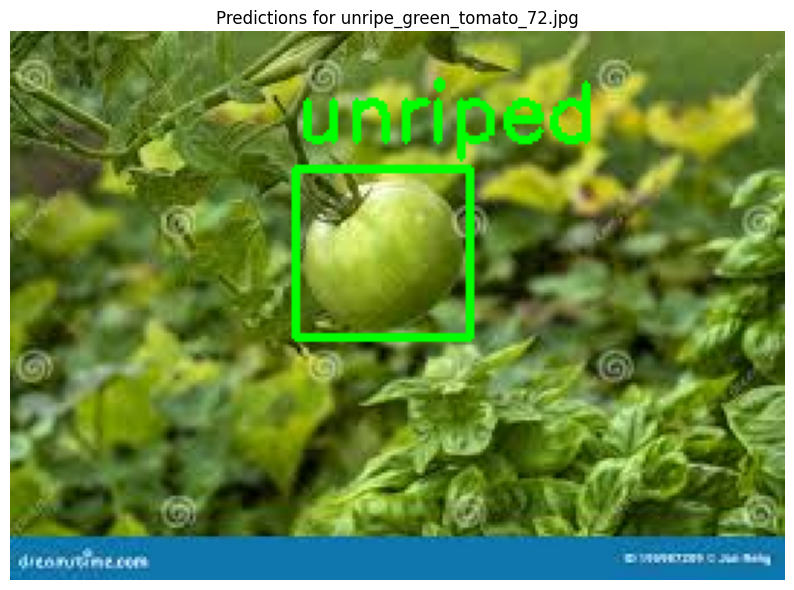


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_44.jpg: 640x640 2 tomatos, 29.2ms
Speed: 4.6ms preprocess, 29.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


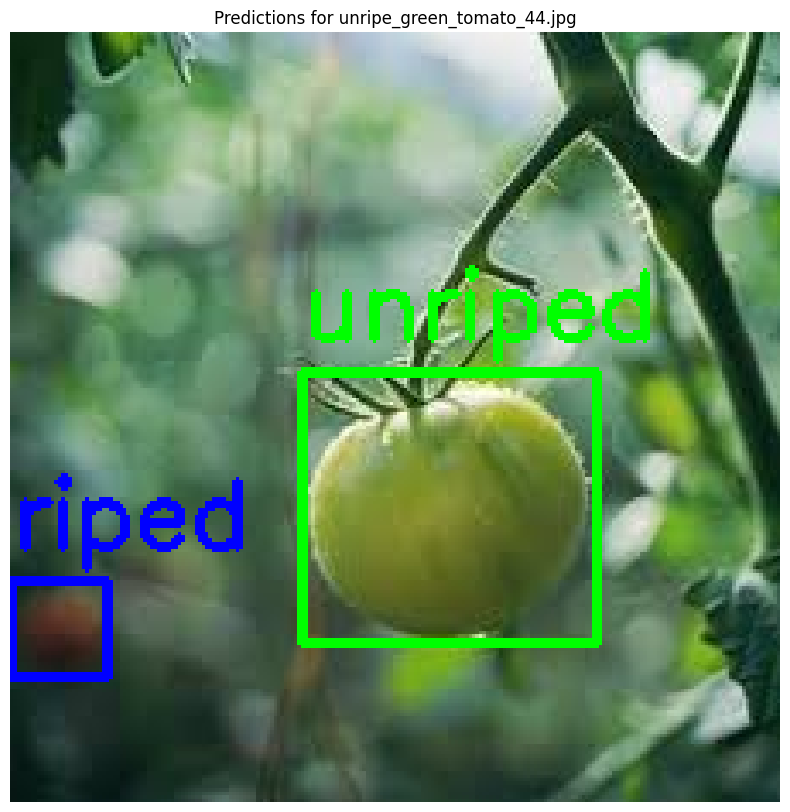


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/26.jpg: 448x640 3 tomatos, 25.6ms
Speed: 3.3ms preprocess, 25.6ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


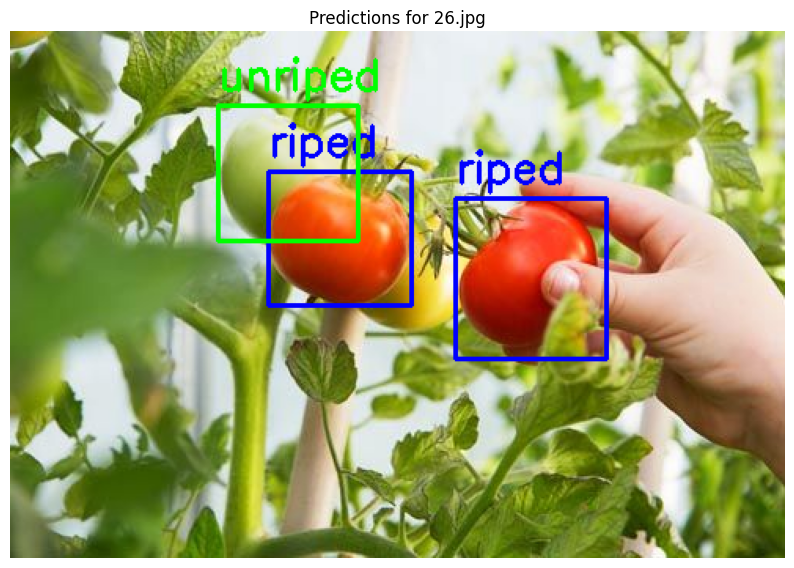


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/23.jpg: 384x640 5 tomatos, 23.7ms
Speed: 3.2ms preprocess, 23.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


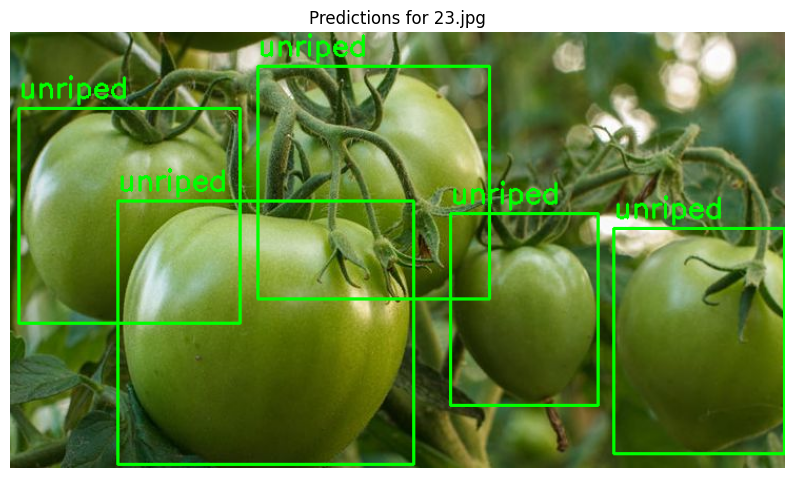


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/25.jpg: 640x448 3 tomatos, 24.9ms
Speed: 4.4ms preprocess, 24.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 448)


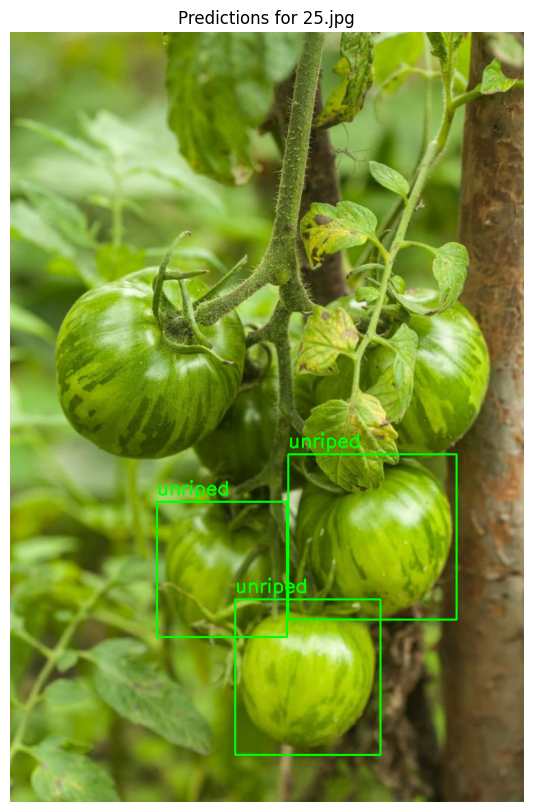


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/22.jpg: 384x640 6 tomatos, 23.7ms
Speed: 3.1ms preprocess, 23.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


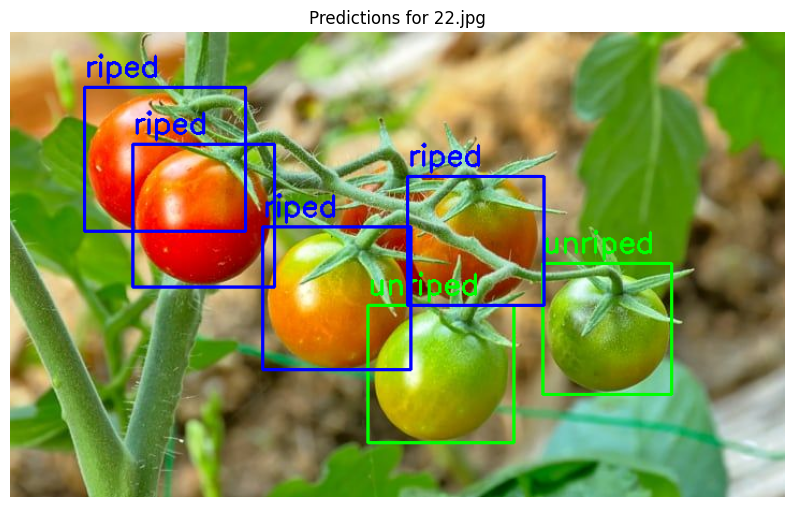


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/16.jpg: 384x640 5 tomatos, 22.6ms
Speed: 3.4ms preprocess, 22.6ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


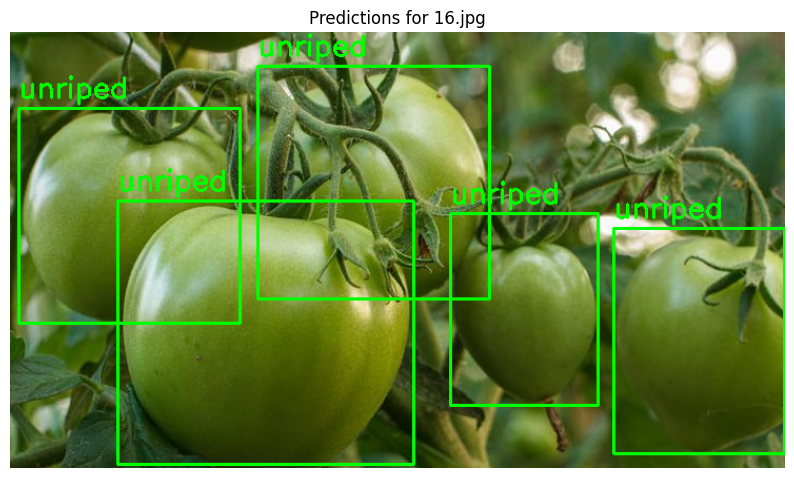


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/12.jpg: 640x512 3 tomatos, 41.2ms
Speed: 3.8ms preprocess, 41.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 512)


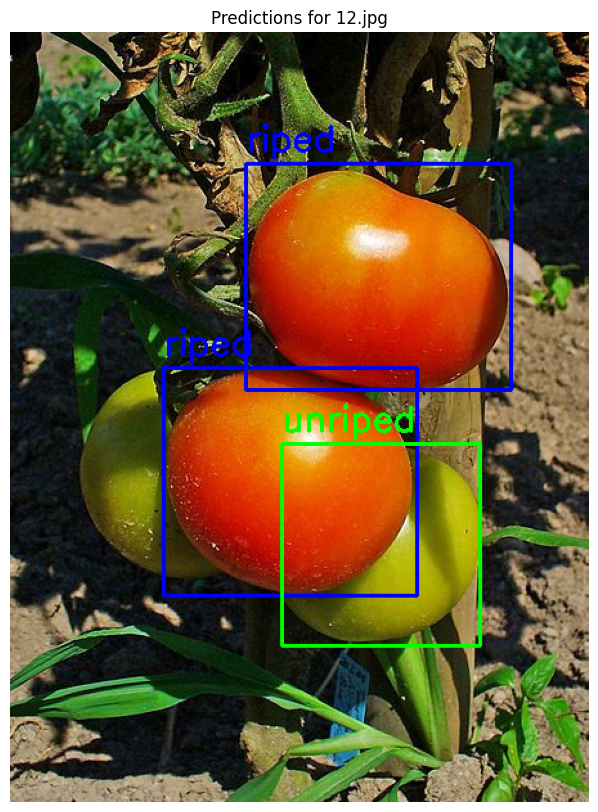


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_74.jpg: 640x384 6 tomatos, 32.9ms
Speed: 3.3ms preprocess, 32.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


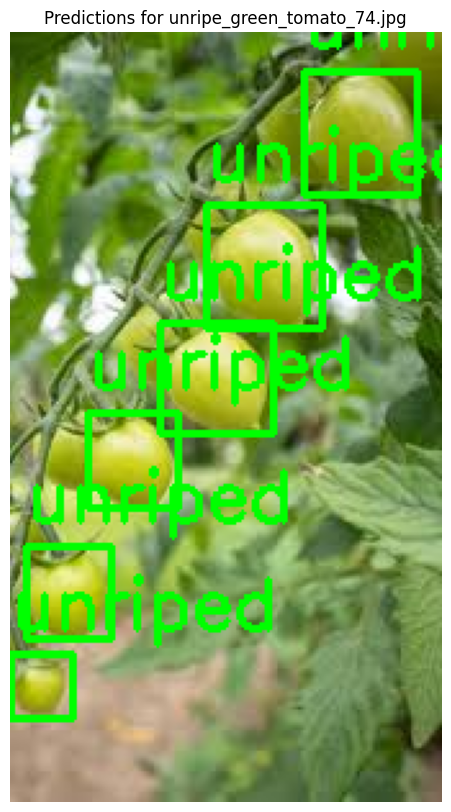


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/11.jpg: 640x448 4 tomatos, 36.0ms
Speed: 4.5ms preprocess, 36.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 448)


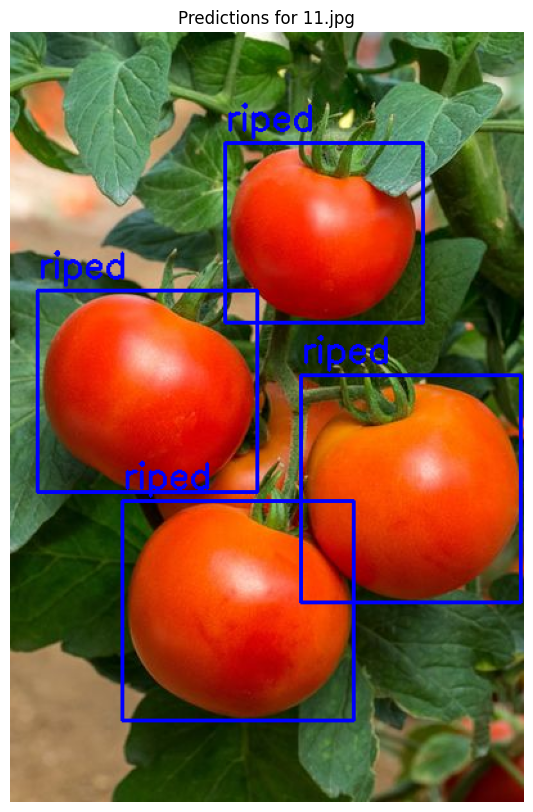


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/28.jpg: 640x480 7 tomatos, 24.8ms
Speed: 4.1ms preprocess, 24.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 480)


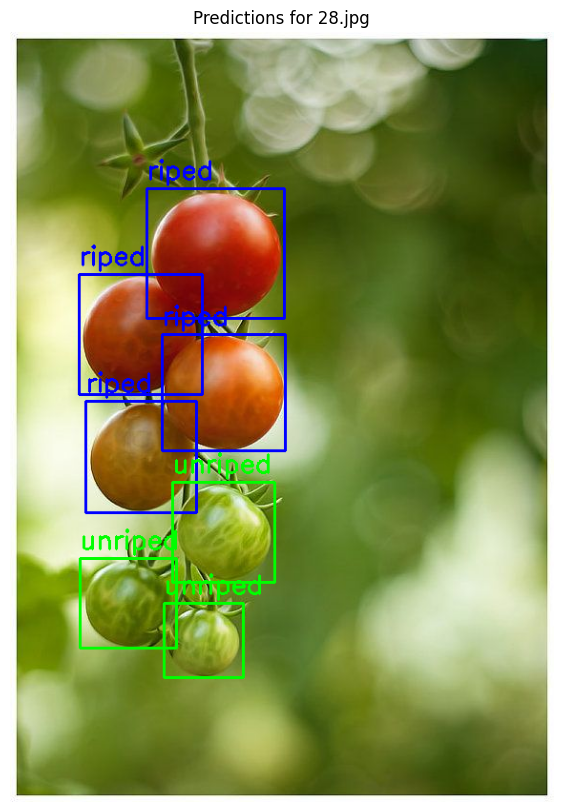


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/18.jpg: 640x448 4 tomatos, 24.7ms
Speed: 3.9ms preprocess, 24.7ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 448)


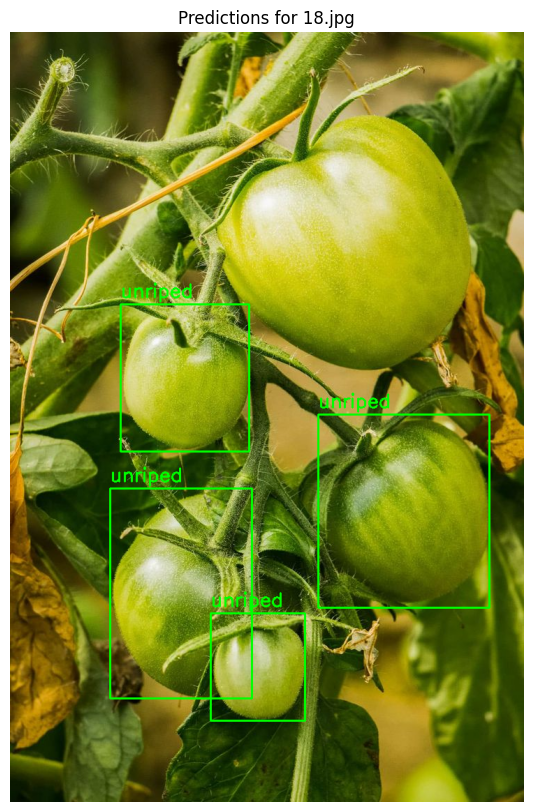


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/8.jpg: 640x448 11 tomatos, 23.5ms
Speed: 4.0ms preprocess, 23.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 448)


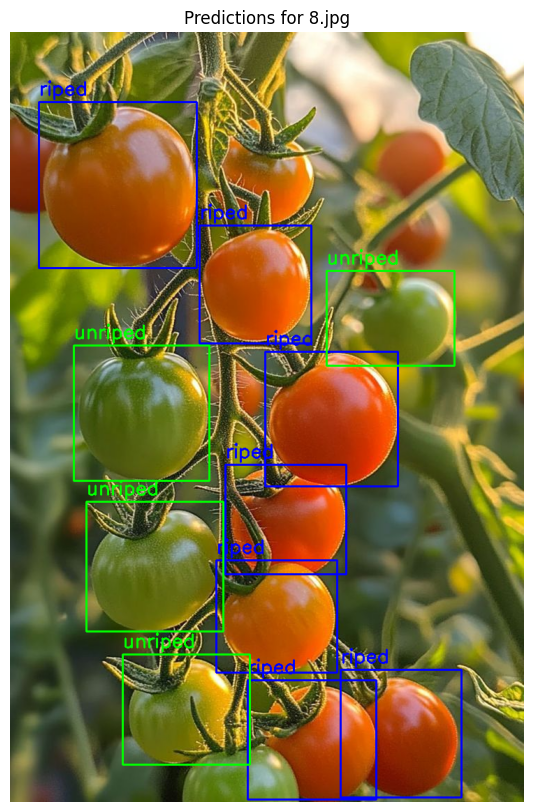


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/3.jpg: 480x640 2 tomatos, 27.8ms
Speed: 3.1ms preprocess, 27.8ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


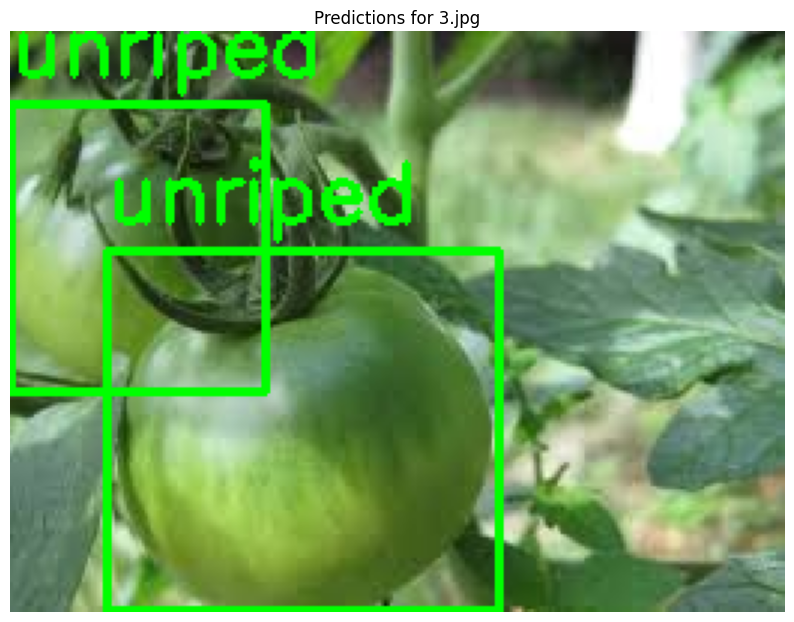


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/32.jpg: 640x448 2 tomatos, 24.3ms
Speed: 3.8ms preprocess, 24.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 448)


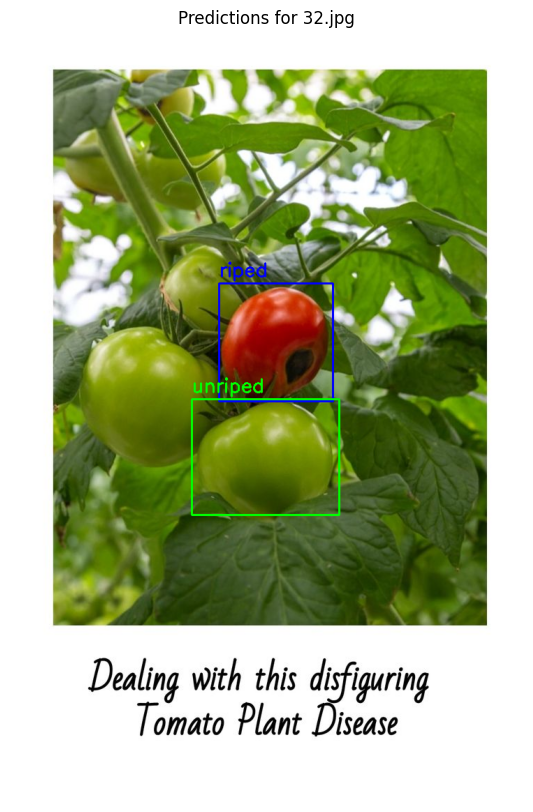


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/21.jpg: 640x512 6 tomatos, 67.3ms
Speed: 22.3ms preprocess, 67.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 512)


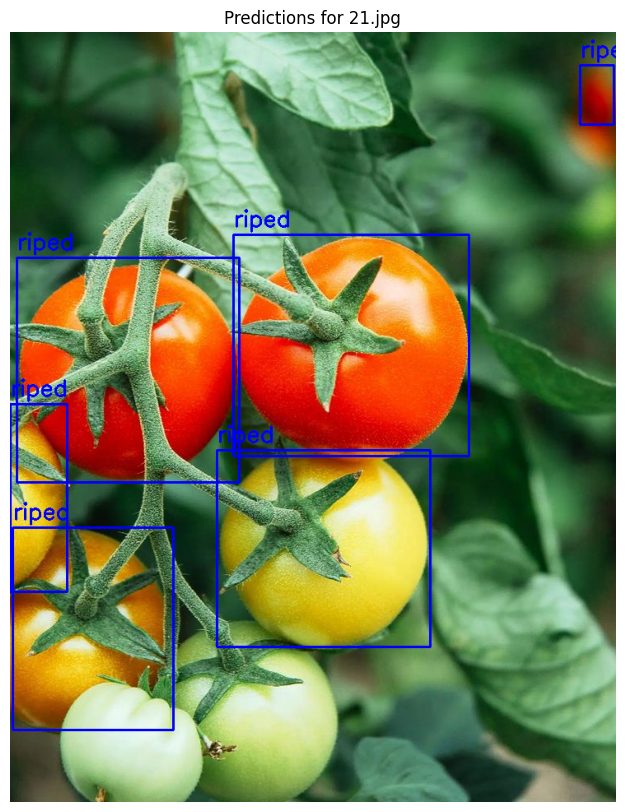


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/29.jpg: 576x640 6 tomatos, 288.4ms
Speed: 31.4ms preprocess, 288.4ms inference, 5.3ms postprocess per image at shape (1, 3, 576, 640)


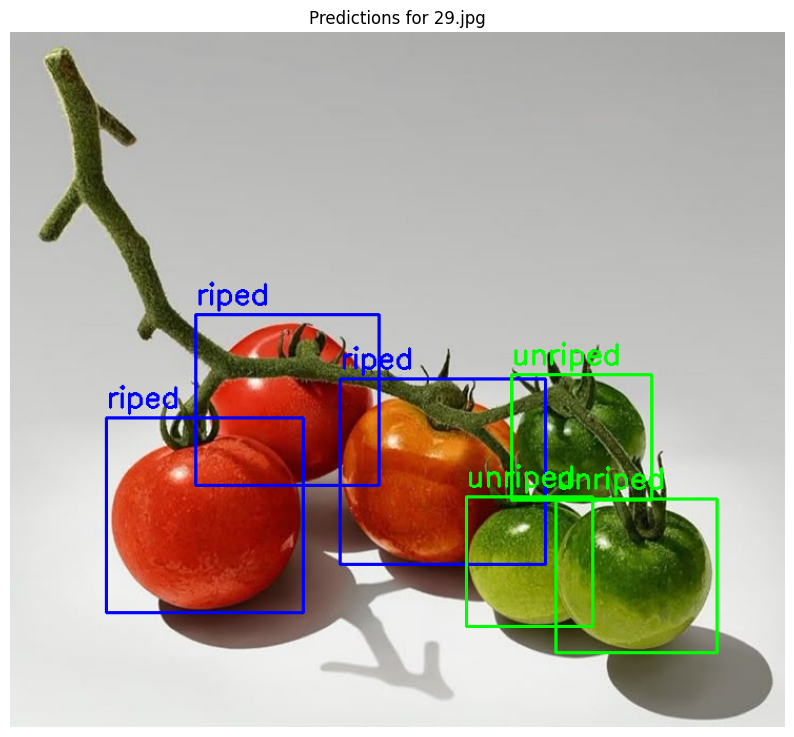


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/17.jpg: 640x640 3 tomatos, 31.9ms
Speed: 4.9ms preprocess, 31.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


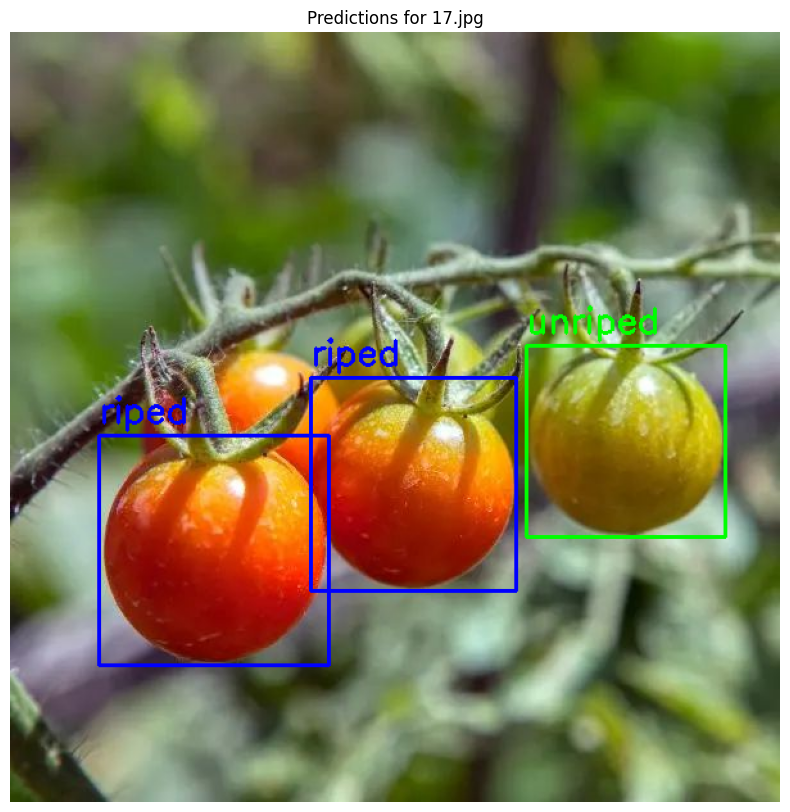


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/10.jpg: 448x640 15 tomatos, 27.6ms
Speed: 4.4ms preprocess, 27.6ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)


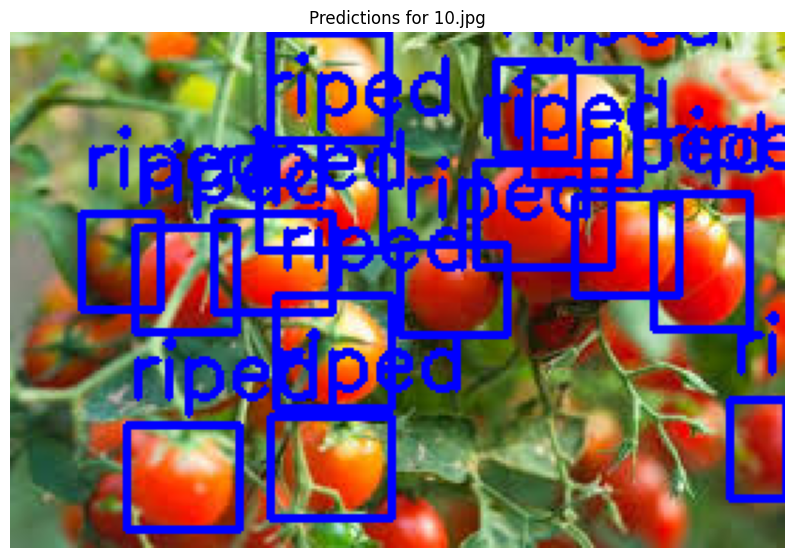


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/6.jpg: 448x640 9 tomatos, 25.6ms
Speed: 4.6ms preprocess, 25.6ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)


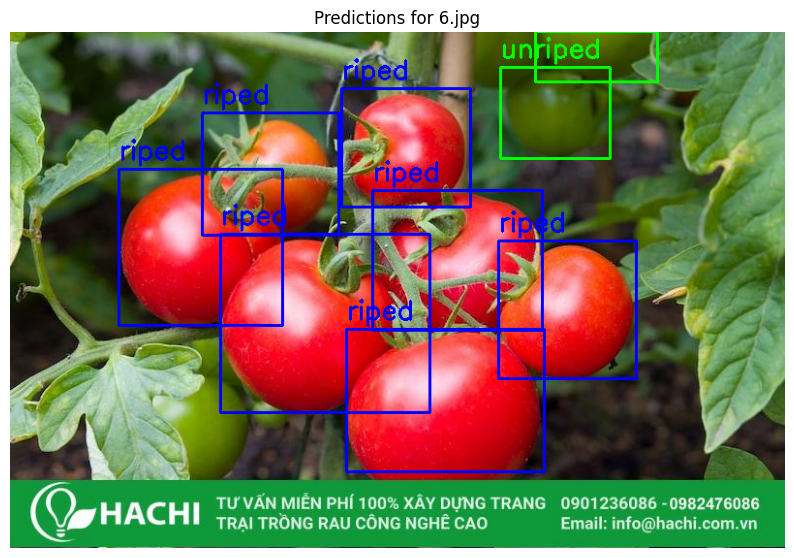


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/20.jpg: 640x416 2 tomatos, 24.9ms
Speed: 3.7ms preprocess, 24.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 416)


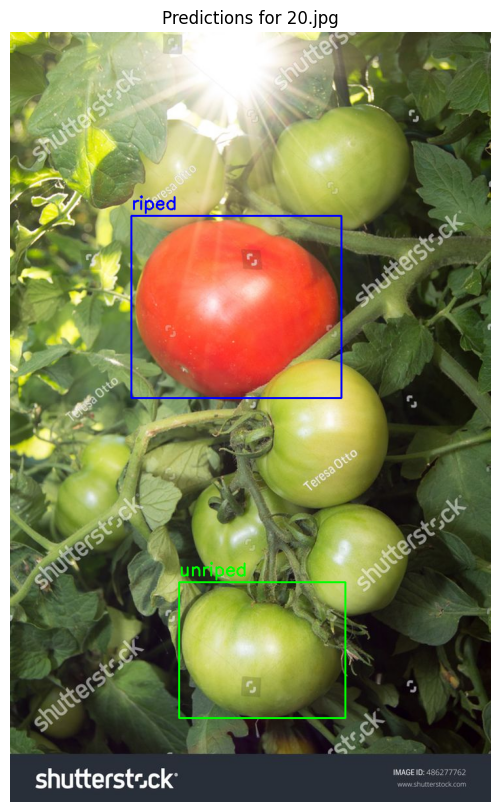


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/4.jpg: 640x640 3 tomatos, 29.8ms
Speed: 5.2ms preprocess, 29.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


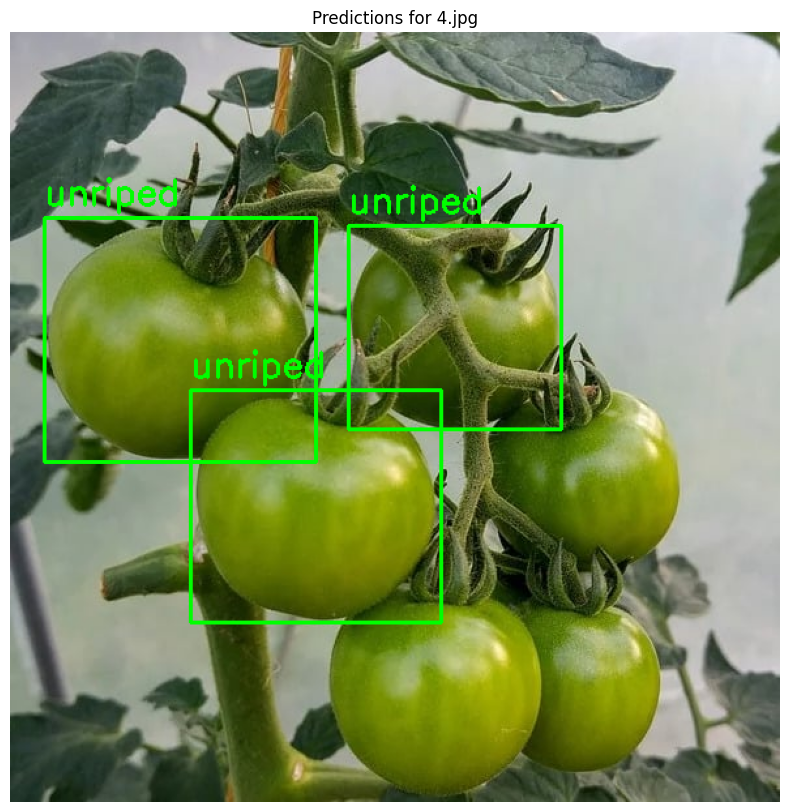


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/unripe_green_tomato_55.jpg: 384x640 4 tomatos, 24.1ms
Speed: 3.4ms preprocess, 24.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


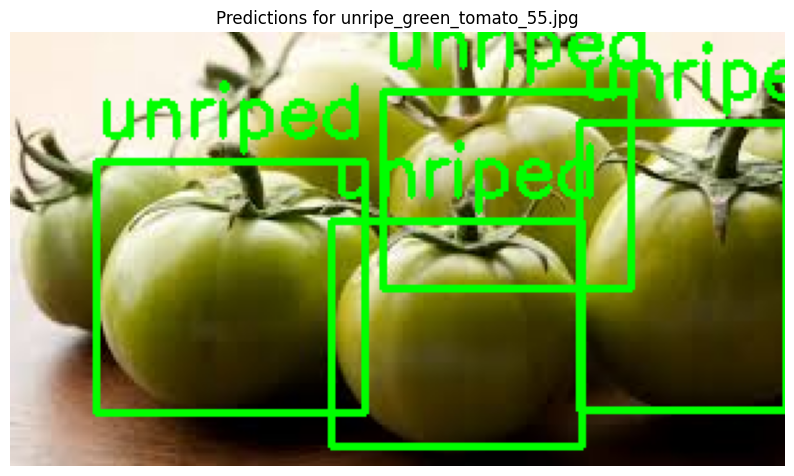


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/7.jpg: 640x448 6 tomatos, 40.3ms
Speed: 3.7ms preprocess, 40.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 448)


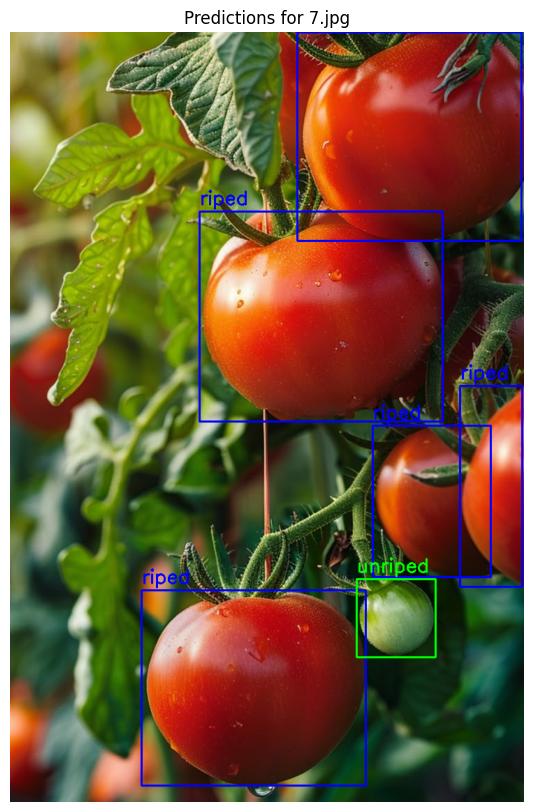


image 1/1 /content/drive/MyDrive/Colab Notebooks/Riped and Unriped Tomato Dataset/tests/5.jpg: 480x640 21 tomatos, 42.3ms
Speed: 8.1ms preprocess, 42.3ms inference, 2.4ms postprocess per image at shape (1, 3, 480, 640)


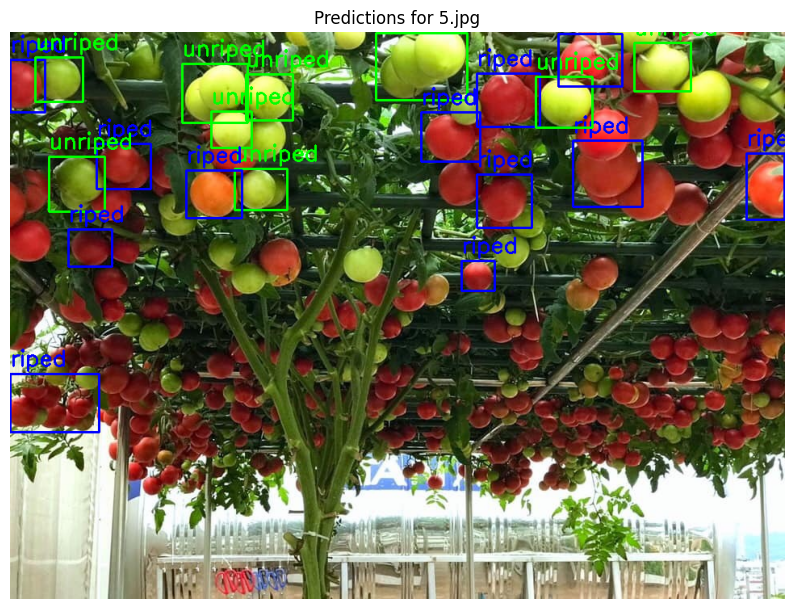

In [28]:
for i in range(20):
    predict_ripeness(image_path=test_images[i], detection_model=detection_model, classifier=classifier, transform=transform, device=device)
    torch.cuda.empty_cache()
    gc.collect()